<a href="https://colab.research.google.com/github/puja-maitra/Unclear/blob/main/(Un)Clear.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount("/content/gdrive")

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
#importing required packages
import tensorflow as tf
import numpy as np
import math
import matplotlib.pyplot as plt
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense , Dropout , Flatten , Conv2D , MaxPooling2D

In [ ]:
import os
import time
os.listdir()

['.config',
 'unclear_training_checkpoints',
 'unclear_logs',
 'gdrive',
 'sample_data']

In [ ]:
#change PATH variable to absolute/relative  path to the images directory on machine which would contain the train and val folders

PATH = '/content/gdrive/My Drive/urban100'              #add path after where done downloading

#defining training variables

EPOCHS = 5    # any more and my machine's gonna d-word although recommended in actual project would be 100+ easily
BUFFER_SIZE = 70    #best buffer size is supposed to be equal to the size of the training dataset but that takes a lot of processing power
BATCH_SIZE = 1   #smaller batch size preffered i think, 4 in example codes
IMG_WIDTH = 256
IMG_HEIGHT = 256  #finally things that can stay as is

In [ ]:
#PREPROCESSING THE DATA (normalization, resizing etc.)

def resize(input_image , real_image , height , width):
  input_image = tf.image.resize(input_image , [height , width] , method = tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  real_image = tf.image.resize(real_image , [height , width] , method = tf.image.ResizeMethod.NEAREST_NEIGHBOR)

  return input_image , real_image

def random_crop(input_image , real_image):
  stacked_image = tf.stack([input_image,real_image] , axis = 0)
  cropped_image = tf.image.random_crop(stacked_image , size = [2, IMG_HEIGHT , IMG_WIDTH ,3])

  return cropped_image[0] , cropped_image[1]

def normalize(input_image , real_image):
  input_image = (input_image/127.5) - 1
  real_image = (real_image/127.5) - 1

  return input_image , real_image

@tf.function()

def random_jitter(input_image , real_image):                            #previous preprocessing functions are used together and random images flipped horizontally
  input_image, real_image = resize(input_image , real_image , 286 , 286)
  input_image , real_image = random_crop(input_image , real_image)

  if tf.random.uniform(()) > 0.5:
    input_image = tf.image.flip_left_right(input_image)
    real_image = tf.image.flip_left_right(real_image)

  return input_image , real_image

In [ ]:
#for getting the unclear images
def unclear(image):
  image = tf.cast(image , tf.float32)
  image1 = tf.image.resize(image , [128 , 128] , method = tf.image.ResizeMethod.NEAREST_NEIGHBOR)    #using input image as half the size of the output
  image1 = tf.image.resize(image1 , [256,256]  , method = tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  return image1



In [ ]:
#loading the image file
def load(image_file):

  image = tf.io.read_file(image_file)
  image = tf.image.decode_png(image)
  real_image = tf.cast(image, tf.float32)
  input_image = unclear(real_image)
  return input_image , real_image


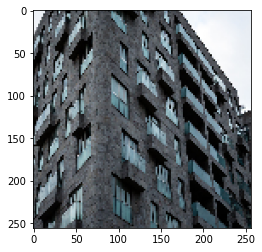

In [ ]:
image = '/content/gdrive/My Drive/urban100/urban100/train/img_001.png'
img1, img2 = load(image)
img1 = img1/255
img1 = unclear(img1)
plt.imshow(img1)
plt.show()

In [ ]:
#loading the test and train data

def load_image_train(image_file):           # outputs final preprocessed image
  input_image , real_image = load(image_file)
  input_image , real_image = random_jitter(input_image , real_image)
  input_image , real_image = normalize(input_image , real_image)

  return input_image , real_image

train_dataset = tf.data.Dataset.list_files(PATH + '/urban100/train/*.png')            # collects path to all png files available in the train/ folder of the dataset
train_dataset = train_dataset.map(load_image_train , num_parallel_calls = tf.data.experimental.AUTOTUNE)    #collection of the paths is mapped through and each path is sent individually as an argument to the load_image_train() function which returns the final preprocessed image and adds it to the train_dataset
train_dataset = train_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)            #shuffled and divided into mini batches

val_dataset = tf.data.Dataset.list_files(PATH + '/urban100/val/*.png')            
val_dataset = val_dataset.map(load_image_train , num_parallel_calls = tf.data.experimental.AUTOTUNE)    #collection of the paths is mapped through and each path is sent individually as an argument to the load_image_train() function which returns the final preprocessed image and adds it to the train_dataset
val_dataset = val_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

#none of the preprocessing except resize and normalize is required for the test dataset obviously

def load_image_test(image_file):
  input_image , real_image = load(image_file)
  return input_image , real_image

test_dataset = tf.data.Dataset.list_files(PATH + '/urban100/test/*.png')
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(BATCH_SIZE)

In [ ]:
#Building the generator model
#here
OUTPUT_CHANNELS = 3

def downsample(filters , size , shape , apply_batchnorm = True):
  initializer = tf.random_normal_initializer(0. , 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters , size , strides = 2 , padding = 'same' , batch_input_shape = shape ,
                             kernel_initializer = initializer , use_bias = False))
  
  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

def upsample(filters , size , shape , apply_dropout = False):
  initializer = tf.random_normal_initializer(0. , 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2DTranspose(filters , size , strides=2 , padding ='same' , batch_input_shape = shape , 
                             kernel_initializer = initializer , use_bias = False))
  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
    result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

def buildGenerator():
    inputs = tf.keras.layers.Input(shape=[256,256,3])

    down_stack = [
        downsample(64, 4, (None, 256, 256, 3), apply_batchnorm=False), # (bs, 128, 128, 64)
        downsample(128, 4, (None, 128, 128, 64)), # (bs, 64, 64, 128)
        downsample(256, 4, (None, 64, 64, 128)), # (bs, 32, 32, 256)
        downsample(512, 4, (None, 32, 32, 256)), # (bs, 16, 16, 512)
        downsample(512, 4, (None, 16, 16, 512)), # (bs, 8, 8, 512)
        downsample(512, 4, (None, 8, 8, 512)), # (bs, 4, 4, 512)
        downsample(512, 4, (None, 4, 4, 512)), # (bs, 2, 2, 512)
        downsample(512, 4, (None, 2, 2, 512)), # (bs, 1, 1, 512)  , this would be the input for the upstack after gettin /2
    ]

    up_stack = [
        upsample(512, 4, (None, 1, 1, 512), apply_dropout=True), # (bs, 2, 2, 1024)
        upsample(512, 4, (None, 2, 2, 1024), apply_dropout=True), # (bs, 4, 4, 1024)
        upsample(512, 4, (None, 4, 4, 1024), apply_dropout=True), # (bs, 8, 8, 1024)
        upsample(512, 4, (None, 8, 8, 1024)), # (bs, 16, 16, 1024)
        upsample(256, 4, (None, 16, 16, 1024)), # (bs, 32, 32, 512)
        upsample(128, 4, (None, 32, 32, 512)), # (bs, 64, 64, 256)
        upsample(64, 4, (None, 64, 64, 256)), # (bs, 128, 128, 128)
    ]

    initializer = tf.random_normal_initializer(0. , 0.02)
    last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS , 4 , strides = 2 , padding = 'same' , kernel_initializer = initializer , activation = 'tanh')  # outputs (bs , 256 , 256 , 3)

    x = inputs 

    skips = []

    for down in down_stack:
      x = down(x)
      skips.append(x)

    skips = reversed(skips[:-1])

    for up , skip in zip(up_stack, skips):
      x = up(x)
      x = tf.keras.layers.Concatenate()([x, skip])

    x = last(x)

    return tf.keras.Model(inputs = inputs , outputs = x)
  
generator = buildGenerator()

In [ ]:
#building the discriminator model
def downs(filters, size, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same', 
                             kernel_initializer=initializer, use_bias=False))

    if apply_batchnorm:
        result.add(tf.keras.layers.BatchNormalization())

    result.add(tf.keras.layers.LeakyReLU())

    return result

def buildDiscriminator():
    initializer = tf.random_normal_initializer(0., 0.02)

    inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
    tar = tf.keras.layers.Input(shape=[256, 256, 3], name='target_image')

    x = tf.keras.layers.concatenate([inp, tar]) # (bs, 256, 256, channels*2)

    down1 = downs(64, 4, False)(x) # (bs, 128, 128, 64)
    down2 = downs(128, 4)(down1) # (bs, 64, 64, 128)
    down3 = downs(256, 4)(down2) # (bs, 32, 32, 256)

    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3) # (bs, 34, 34, 256)
    conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1) # (bs, 31, 31, 512)

    batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

    leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (bs, 33, 33, 512)

    last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2) # (bs, 30, 30, 1)

    return tf.keras.Model(inputs=[inp, tar], outputs=last)
  
discriminator = buildDiscriminator()

In [ ]:

loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

LAMBDA = 100

def generator_loss(disc_generated_output, gen_output, target):
    gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

    total_gen_loss = gan_loss + (LAMBDA * l1_loss)

    return total_gen_loss, gan_loss, l1_loss


def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

    generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

    total_disc_loss = real_loss + generated_loss

    return total_disc_loss

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [ ]:
checkpoint_dir = './unclear_training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [ ]:
def generate_images(model, test_input, tar):
    prediction = model(test_input, training=True)
    plt.figure(figsize=(15,15))

    display_list = [test_input[0], tar[0], prediction[0]]
    title = ['Input Image', 'Ground Truth', 'Predicted Image']

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i] * 0.5 + 0.5)
        plt.axis('off')
    plt.show()

In [ ]:
#logging the losses
import datetime
log_dir="unclear_logs/"

summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [ ]:
#summary

@tf.function
def train_step(input_image, target, epoch):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_output = generator(input_image, training=True)

        disc_real_output = discriminator([input_image, target], training=True)
        disc_generated_output = discriminator([input_image, gen_output], training=True)

        gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
        disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

    generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
    discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

    with summary_writer.as_default():
        tf.summary.scalar('gen_total_loss', gen_total_loss, step=epoch)
        tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=epoch)
        tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=epoch)
        tf.summary.scalar('disc_loss', disc_loss, step=epoch)

In [ ]:
def fit(train_ds, epochs, test_ds):
    for epoch in range(epochs):
        start = time.time()

        for example_input, example_target in test_ds.take(1):
            generate_images(generator, example_input, example_target)
        print("Epoch: ", epoch)

        for n, (input_image, target) in train_ds.enumerate():
            print('.', end='')
            if (n+1) % 100 == 0:
                print()
            train_step(input_image, target, epoch)
        print()

        if (epoch + 1) % 5 == 0:
            checkpoint.save(file_prefix = checkpoint_prefix)

        print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1,
                                                        time.time()-start))
    checkpoint.save(file_prefix = checkpoint_prefix)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


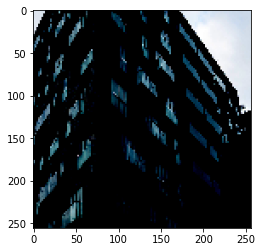

In [ ]:
image = '/content/gdrive/My Drive/urban100/urban100/train/img_001.png'
img1, img2 = load(image)
img1 , img2 = normalize(img1,img2)
img1 = unclear(img1)
plt.imshow(img1)
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


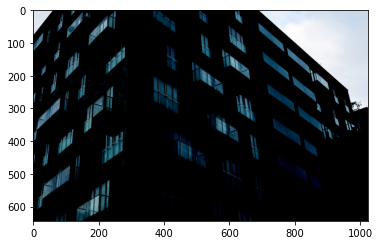

In [ ]:
plt.imshow(img2)
plt.show()

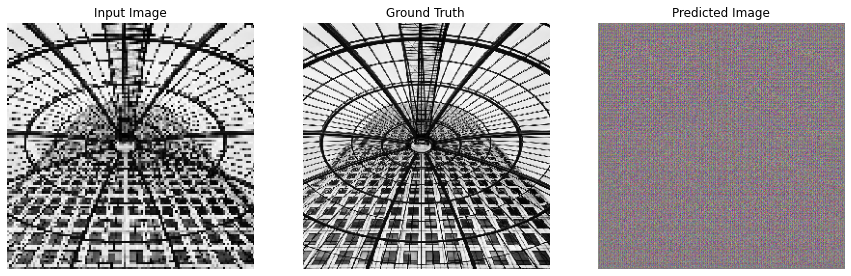

Epoch:  0
......................................................................
Time taken for epoch 1 is 16.83415126800537 sec



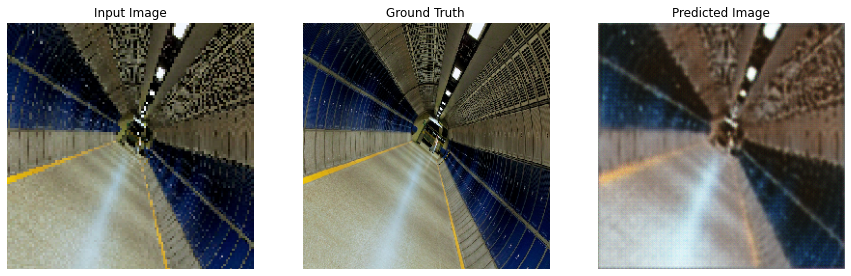

Epoch:  1
......................................................................
Time taken for epoch 2 is 10.682291746139526 sec



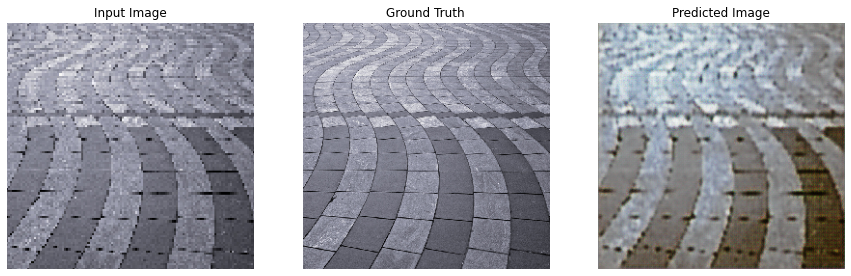

Epoch:  2
......................................................................
Time taken for epoch 3 is 10.545220613479614 sec



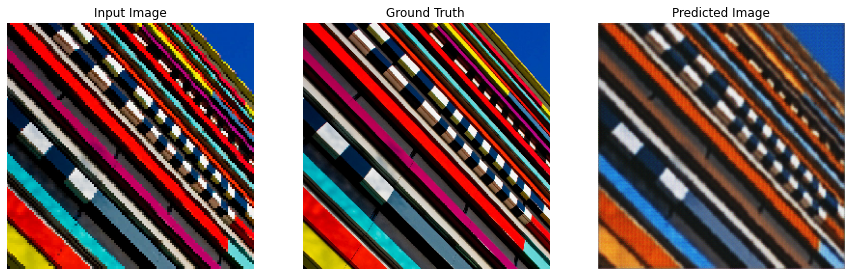

Epoch:  3
......................................................................
Time taken for epoch 4 is 10.349100589752197 sec



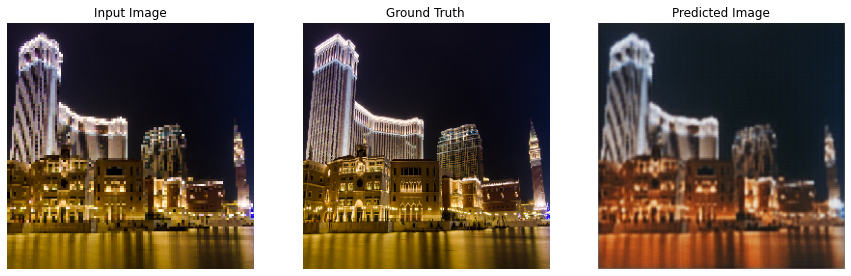

Epoch:  4
......................................................................
Time taken for epoch 5 is 12.898481845855713 sec



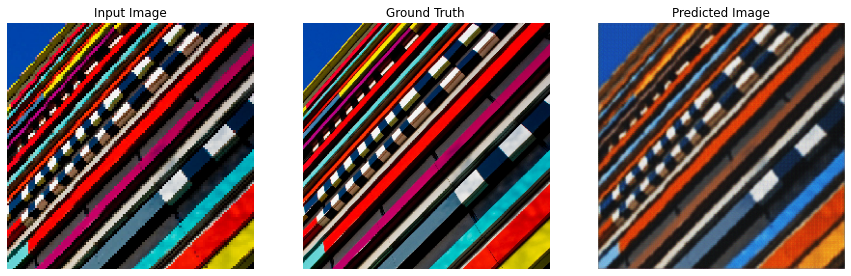

Epoch:  5
......................................................................
Time taken for epoch 6 is 10.75436782836914 sec



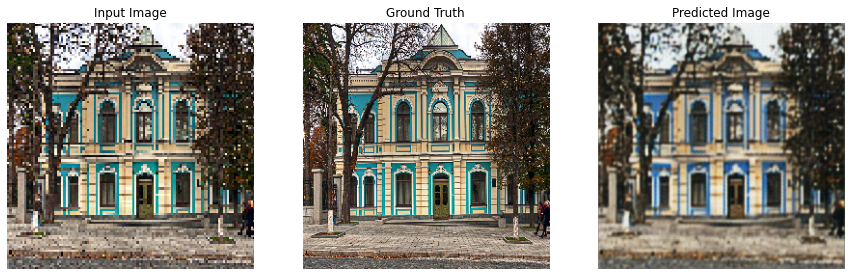

Epoch:  6
......................................................................
Time taken for epoch 7 is 10.804386854171753 sec



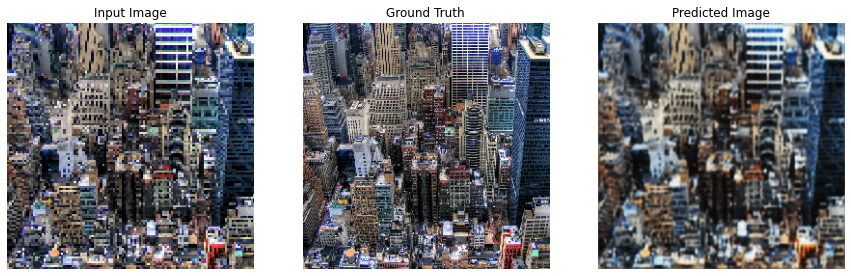

Epoch:  7
......................................................................
Time taken for epoch 8 is 10.832473278045654 sec



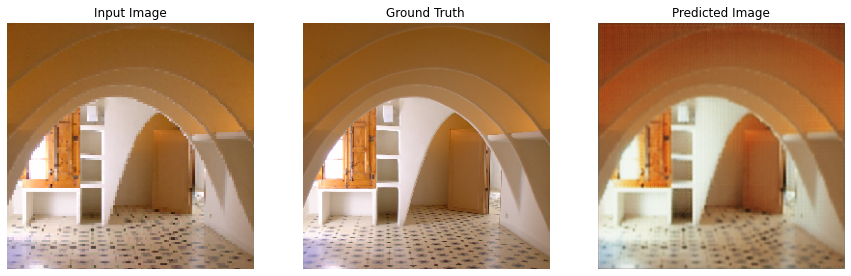

Epoch:  8
......................................................................
Time taken for epoch 9 is 10.413190603256226 sec



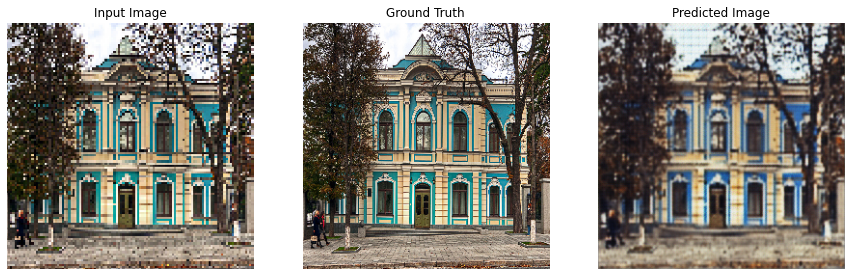

Epoch:  9
......................................................................
Time taken for epoch 10 is 12.79198694229126 sec



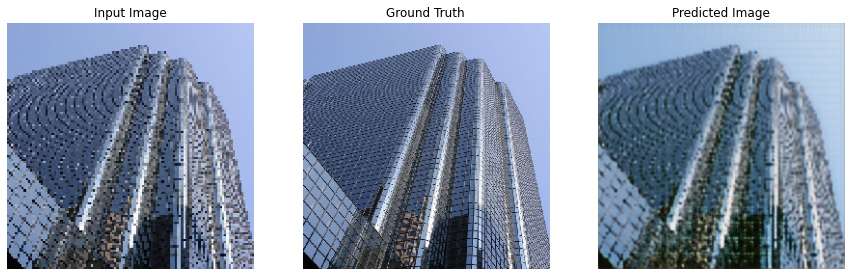

Epoch:  10
......................................................................
Time taken for epoch 11 is 10.585362434387207 sec



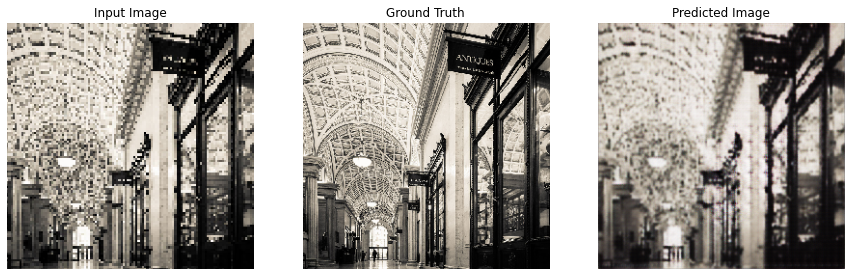

Epoch:  11
......................................................................
Time taken for epoch 12 is 11.176812648773193 sec



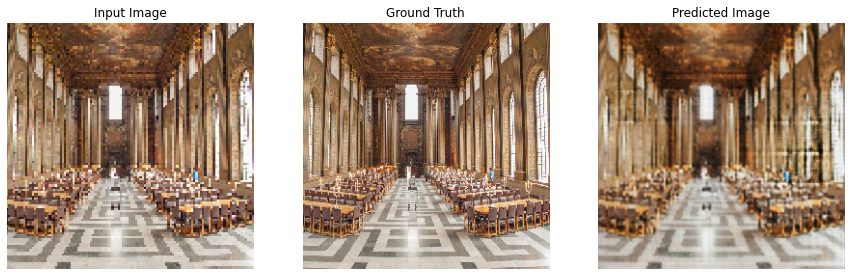

Epoch:  12
......................................................................
Time taken for epoch 13 is 10.955681800842285 sec



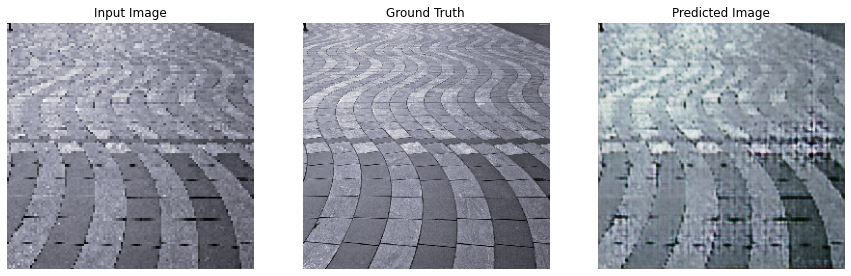

Epoch:  13
......................................................................
Time taken for epoch 14 is 10.875020503997803 sec



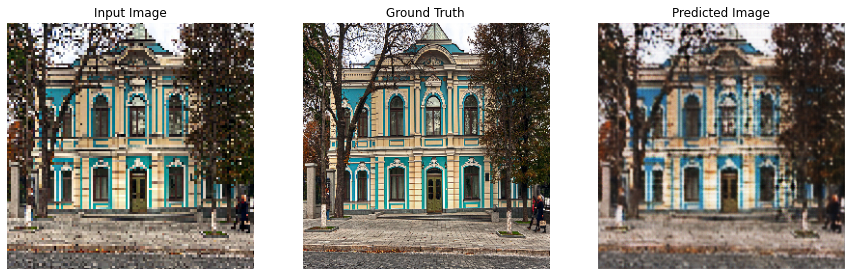

Epoch:  14
......................................................................
Time taken for epoch 15 is 13.06827688217163 sec



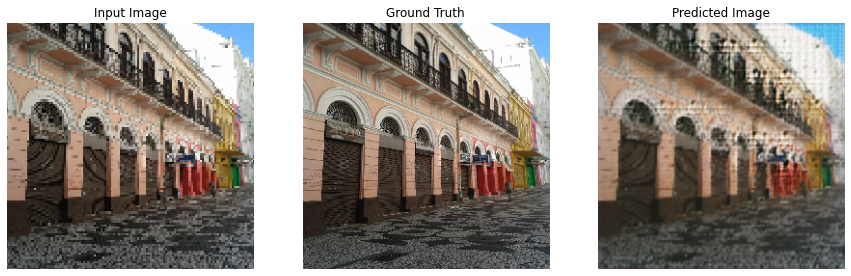

Epoch:  15
......................................................................
Time taken for epoch 16 is 10.756131172180176 sec



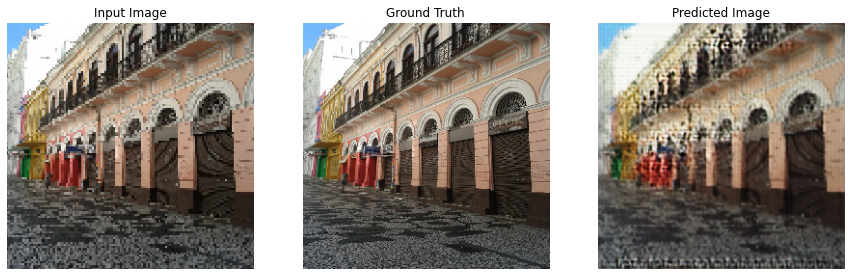

Epoch:  16
......................................................................
Time taken for epoch 17 is 11.018350839614868 sec



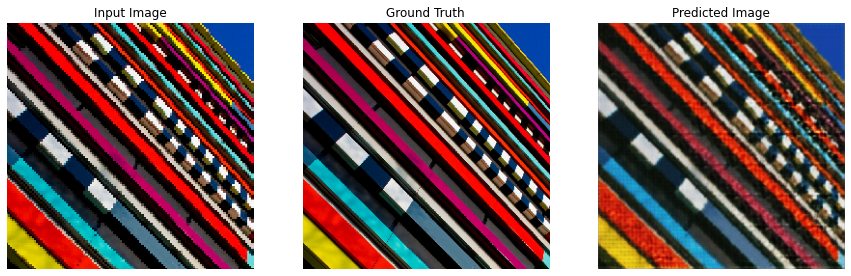

Epoch:  17
......................................................................
Time taken for epoch 18 is 10.738389015197754 sec



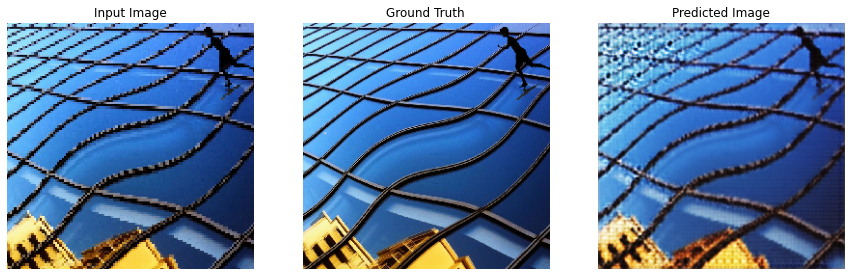

Epoch:  18
......................................................................
Time taken for epoch 19 is 10.995535373687744 sec



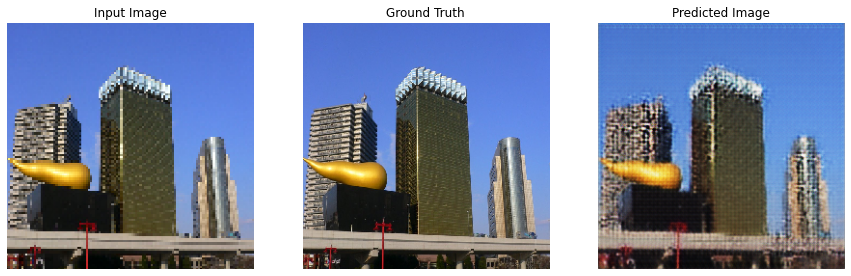

Epoch:  19
......................................................................
Time taken for epoch 20 is 13.454329013824463 sec



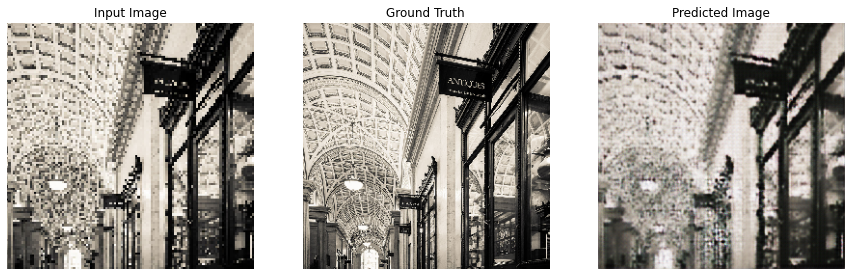

Epoch:  20
......................................................................
Time taken for epoch 21 is 11.045395851135254 sec



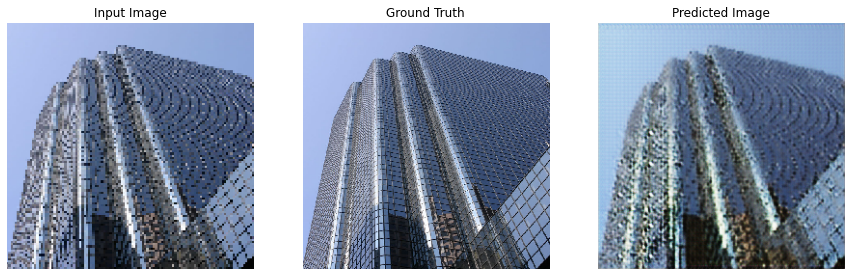

Epoch:  21
......................................................................
Time taken for epoch 22 is 10.862809896469116 sec



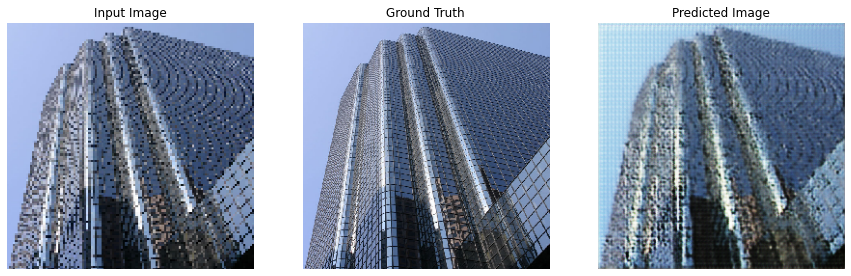

Epoch:  22
......................................................................
Time taken for epoch 23 is 12.181825399398804 sec



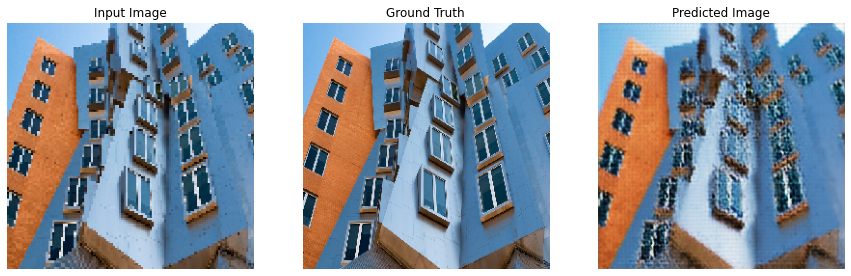

Epoch:  23
......................................................................
Time taken for epoch 24 is 10.833309888839722 sec



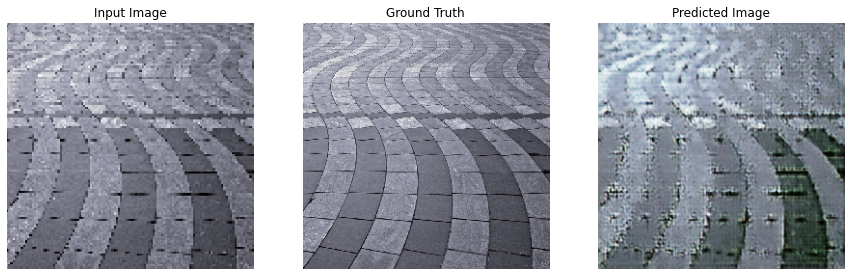

Epoch:  24
......................................................................
Time taken for epoch 25 is 13.133477926254272 sec



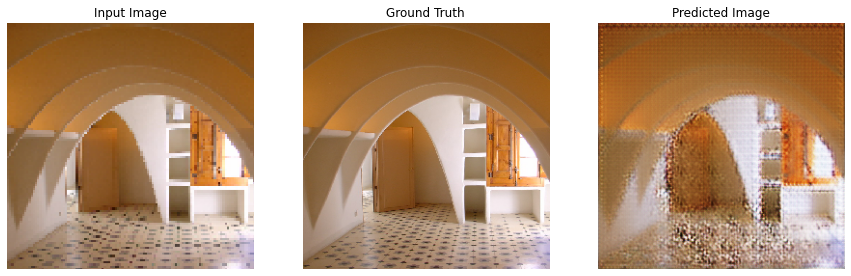

Epoch:  25
......................................................................
Time taken for epoch 26 is 10.852266788482666 sec



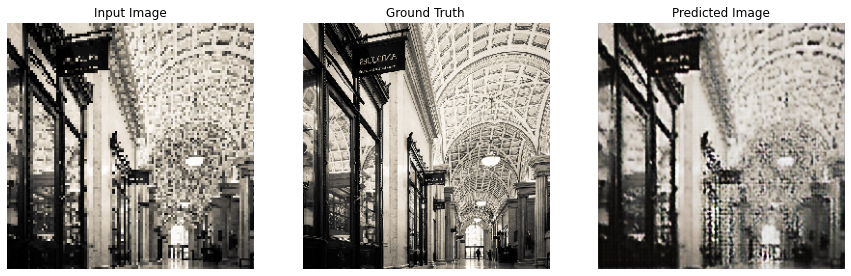

Epoch:  26
......................................................................
Time taken for epoch 27 is 11.08674168586731 sec



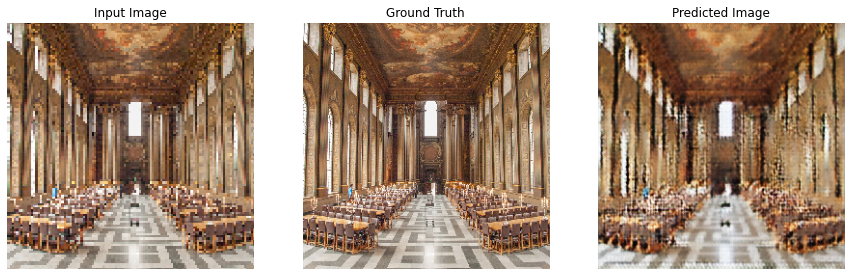

Epoch:  27
......................................................................
Time taken for epoch 28 is 11.132503271102905 sec



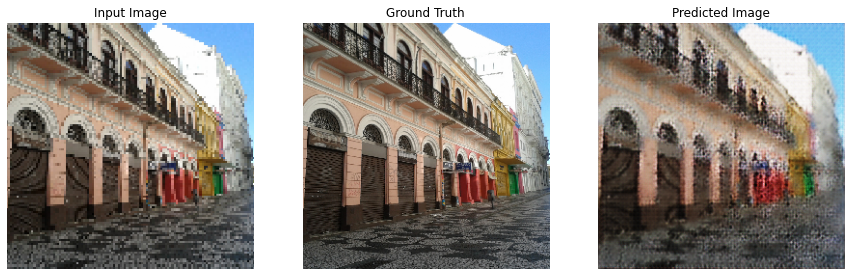

Epoch:  28
......................................................................
Time taken for epoch 29 is 10.7181396484375 sec



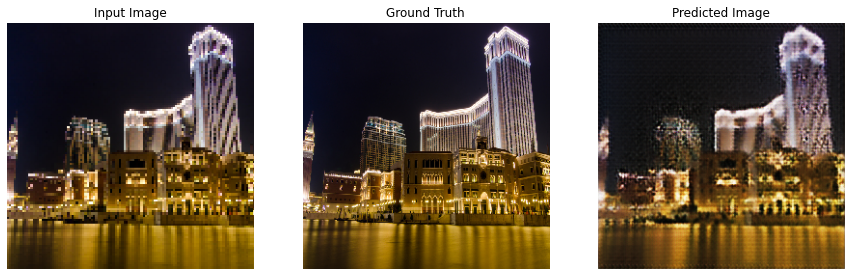

Epoch:  29
......................................................................
Time taken for epoch 30 is 13.469830513000488 sec



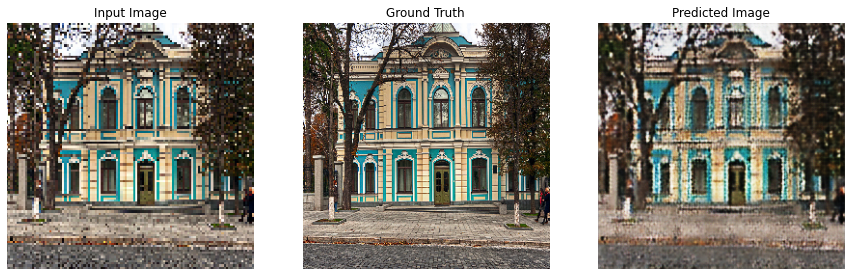

Epoch:  30
......................................................................
Time taken for epoch 31 is 10.677456378936768 sec



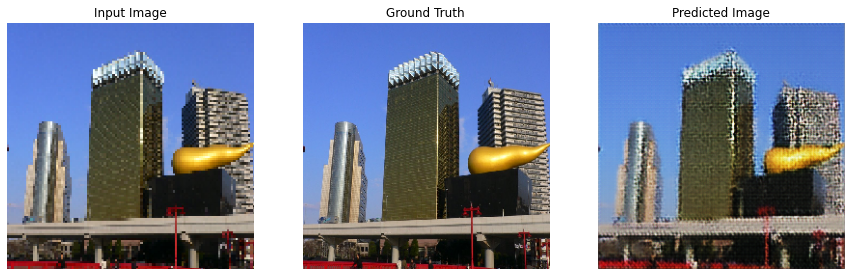

Epoch:  31
......................................................................
Time taken for epoch 32 is 10.587585926055908 sec



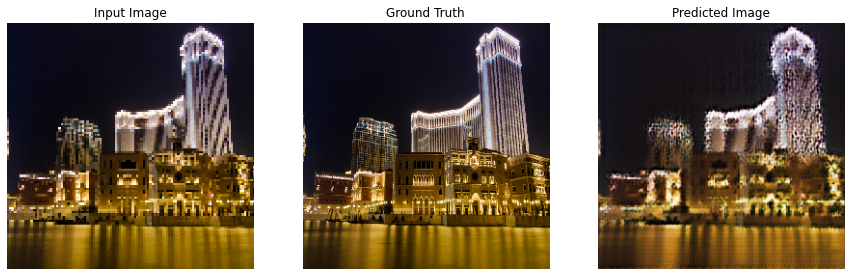

Epoch:  32
......................................................................
Time taken for epoch 33 is 10.968058347702026 sec



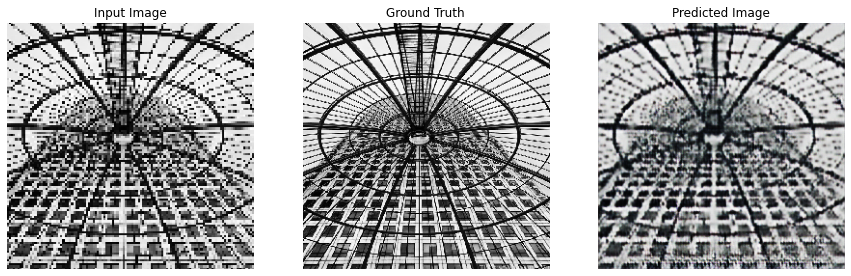

Epoch:  33
......................................................................
Time taken for epoch 34 is 10.925485849380493 sec



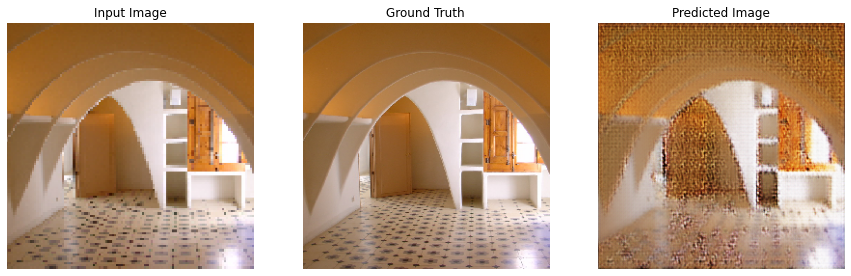

Epoch:  34
......................................................................
Time taken for epoch 35 is 12.944746732711792 sec



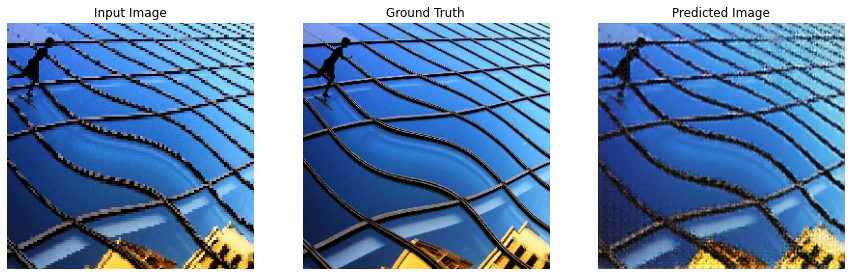

Epoch:  35
......................................................................
Time taken for epoch 36 is 10.67939281463623 sec



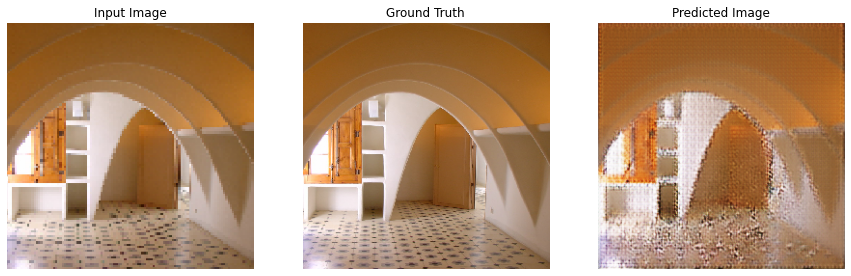

Epoch:  36
......................................................................
Time taken for epoch 37 is 10.654034852981567 sec



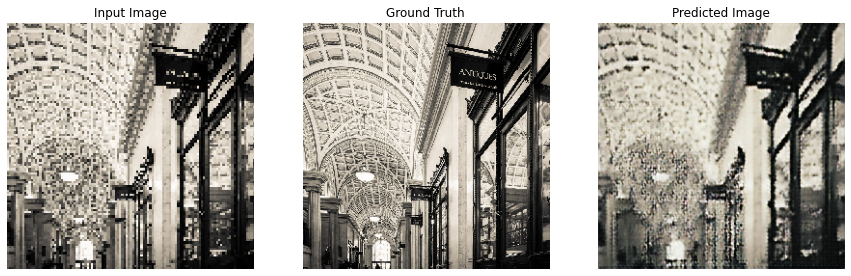

Epoch:  37
......................................................................
Time taken for epoch 38 is 11.254700899124146 sec



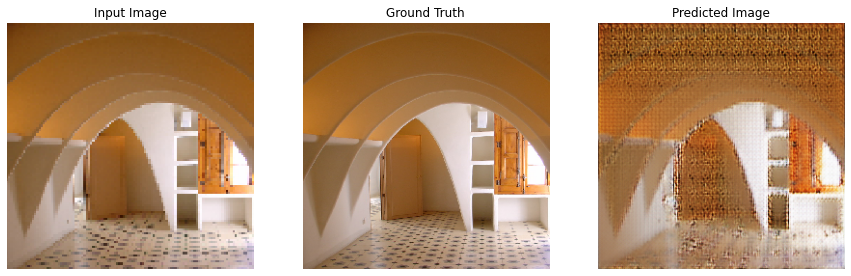

Epoch:  38
......................................................................
Time taken for epoch 39 is 10.983370065689087 sec



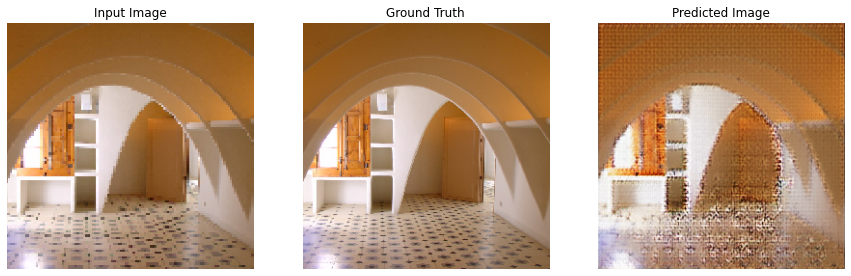

Epoch:  39
......................................................................
Time taken for epoch 40 is 13.376310110092163 sec



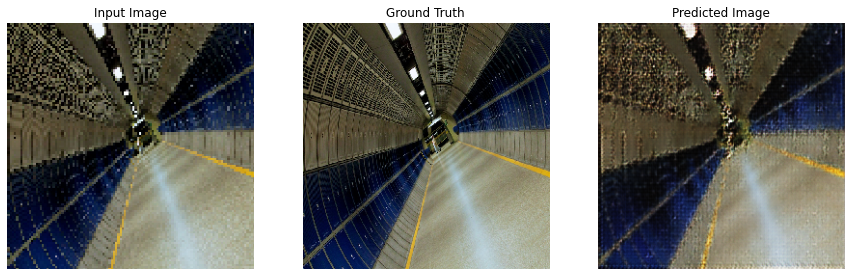

Epoch:  40
......................................................................
Time taken for epoch 41 is 10.827755451202393 sec



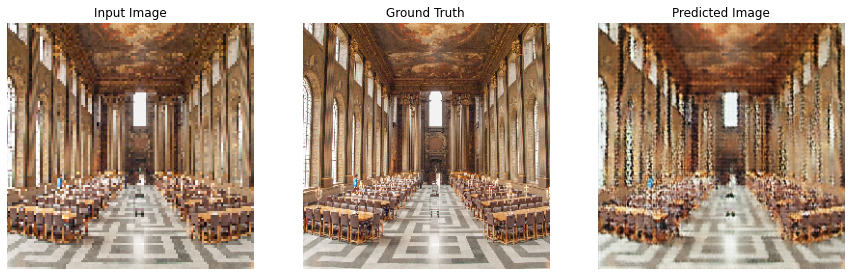

Epoch:  41
......................................................................
Time taken for epoch 42 is 10.75632119178772 sec



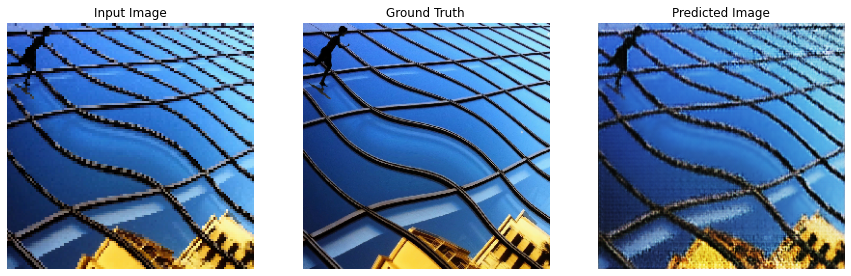

Epoch:  42
......................................................................
Time taken for epoch 43 is 10.77984094619751 sec



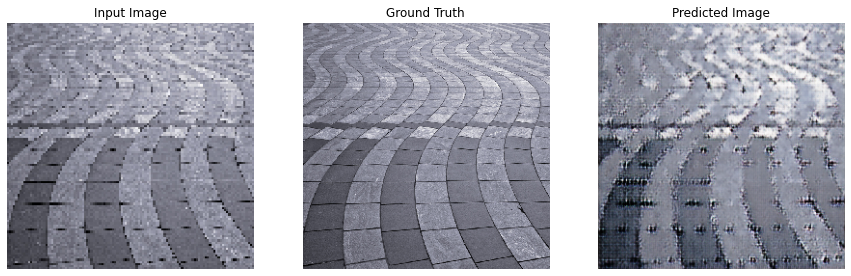

Epoch:  43
......................................................................
Time taken for epoch 44 is 10.927812099456787 sec



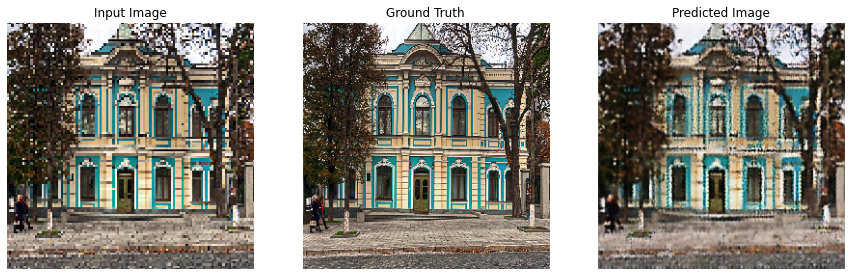

Epoch:  44
......................................................................
Time taken for epoch 45 is 13.938337326049805 sec



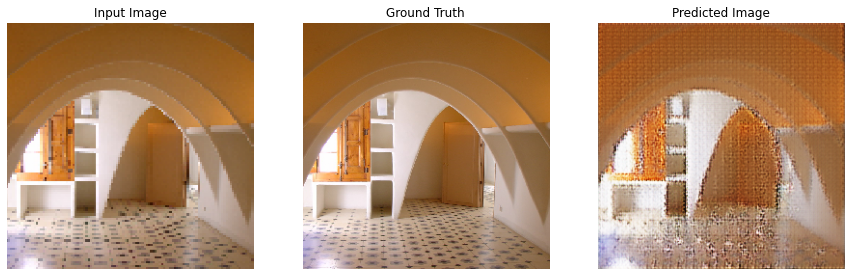

Epoch:  45
......................................................................
Time taken for epoch 46 is 11.548384428024292 sec



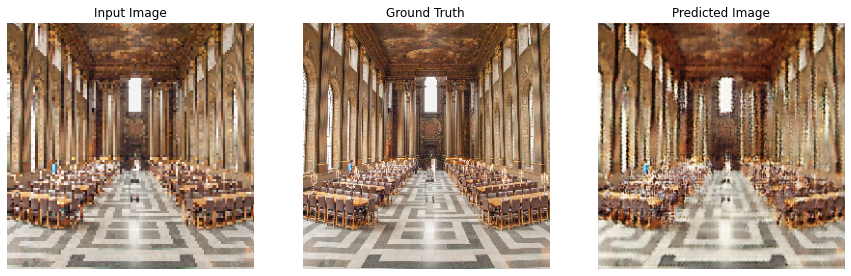

Epoch:  46
......................................................................
Time taken for epoch 47 is 11.19459080696106 sec



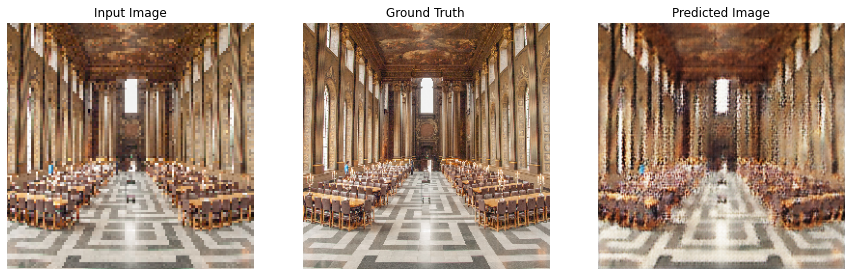

Epoch:  47
......................................................................
Time taken for epoch 48 is 10.998547315597534 sec



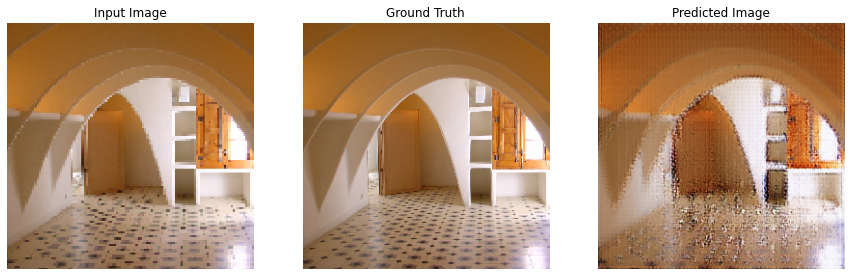

Epoch:  48
......................................................................
Time taken for epoch 49 is 12.106722831726074 sec



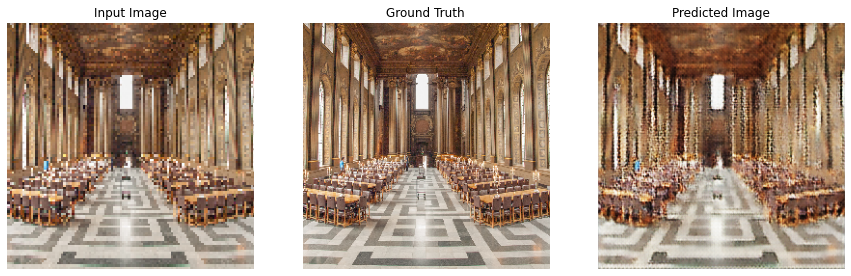

Epoch:  49
......................................................................
Time taken for epoch 50 is 14.168151140213013 sec



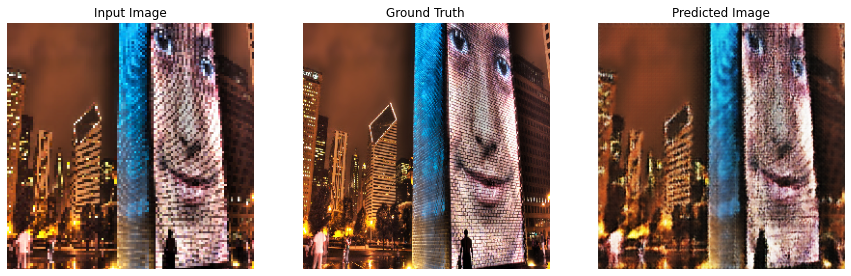

Epoch:  50
......................................................................
Time taken for epoch 51 is 11.198285341262817 sec



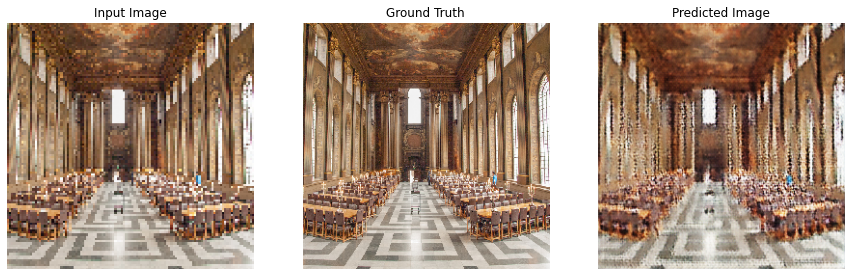

Epoch:  51
......................................................................
Time taken for epoch 52 is 11.39560055732727 sec



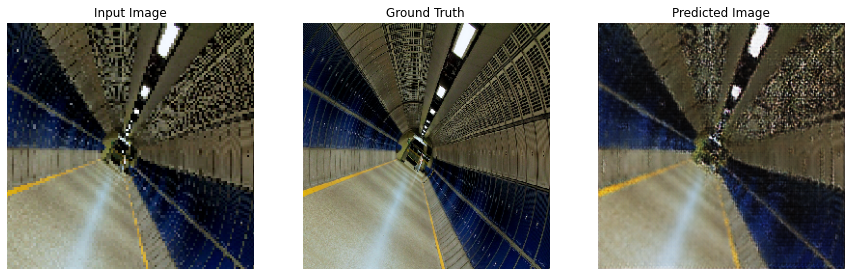

Epoch:  52
......................................................................
Time taken for epoch 53 is 12.39612078666687 sec



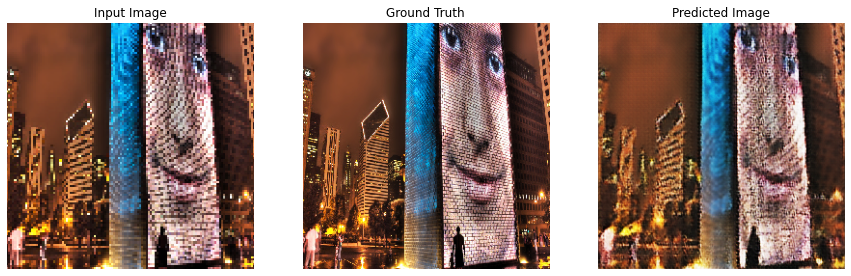

Epoch:  53
......................................................................
Time taken for epoch 54 is 12.358312129974365 sec



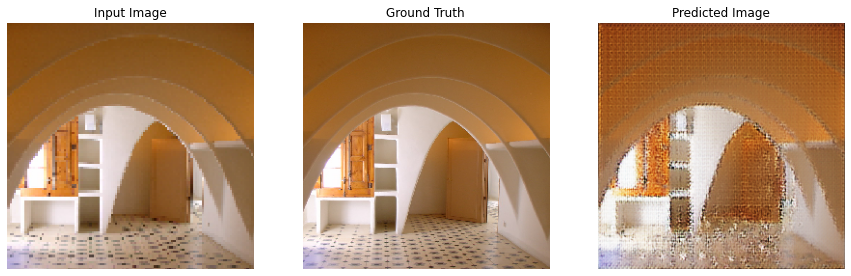

Epoch:  54
......................................................................
Time taken for epoch 55 is 14.724842309951782 sec



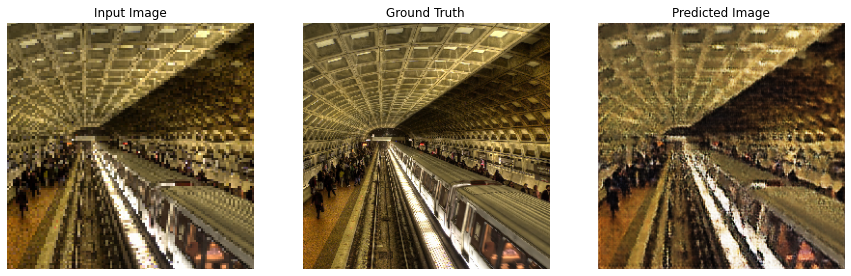

Epoch:  55
......................................................................
Time taken for epoch 56 is 10.920636415481567 sec



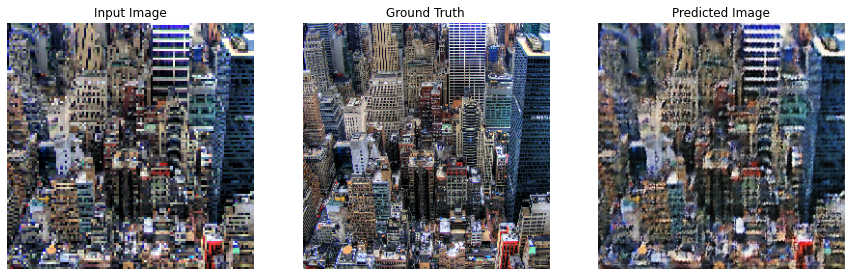

Epoch:  56
......................................................................
Time taken for epoch 57 is 12.174540281295776 sec



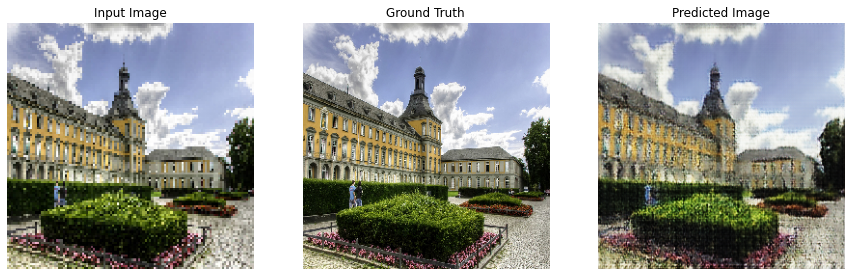

Epoch:  57
......................................................................
Time taken for epoch 58 is 12.400708198547363 sec



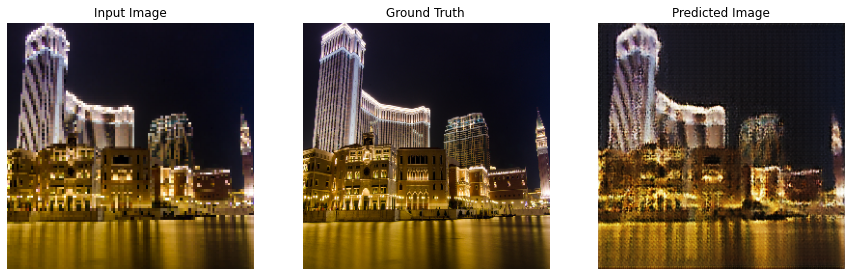

Epoch:  58
......................................................................
Time taken for epoch 59 is 12.984031915664673 sec



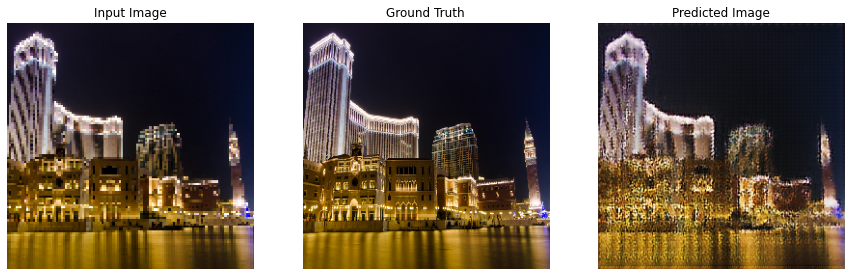

Epoch:  59
......................................................................
Time taken for epoch 60 is 14.915536165237427 sec



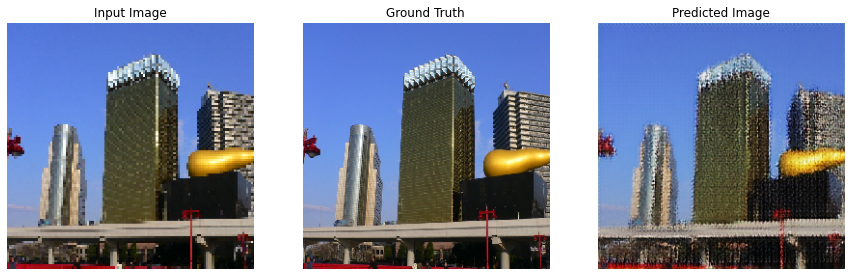

Epoch:  60
......................................................................
Time taken for epoch 61 is 11.088515996932983 sec



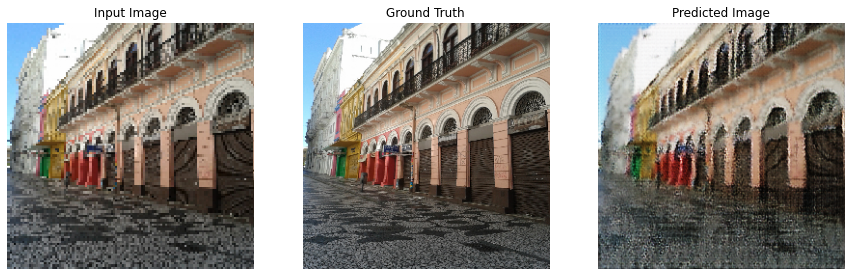

Epoch:  61
......................................................................
Time taken for epoch 62 is 12.17650818824768 sec



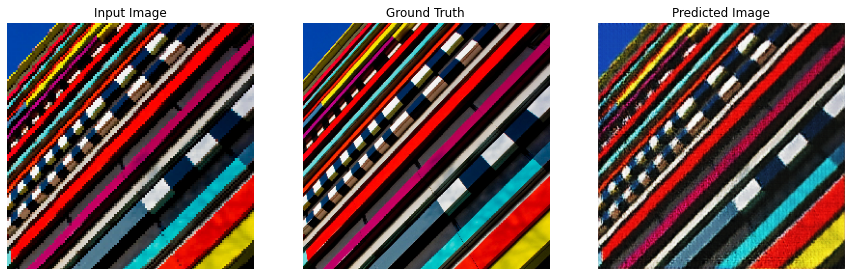

Epoch:  62
......................................................................
Time taken for epoch 63 is 12.724634647369385 sec



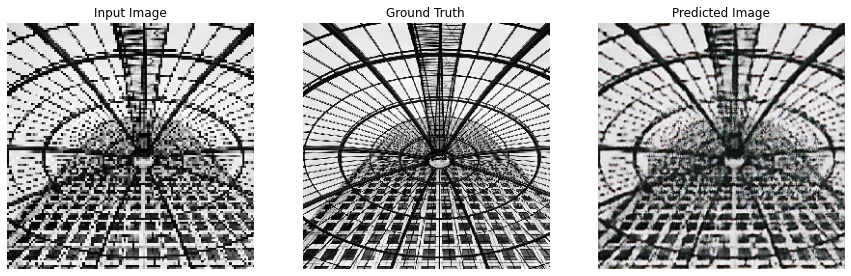

Epoch:  63
......................................................................
Time taken for epoch 64 is 13.01585578918457 sec



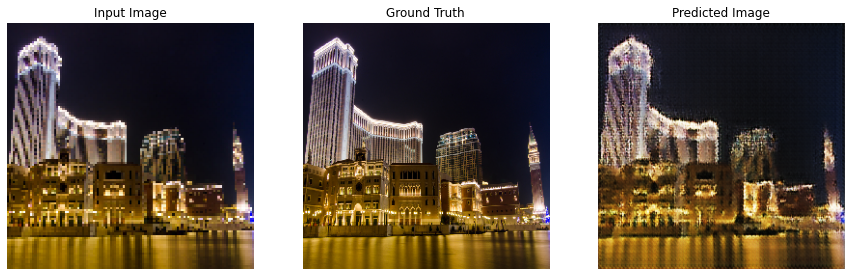

Epoch:  64
......................................................................
Time taken for epoch 65 is 15.243590116500854 sec



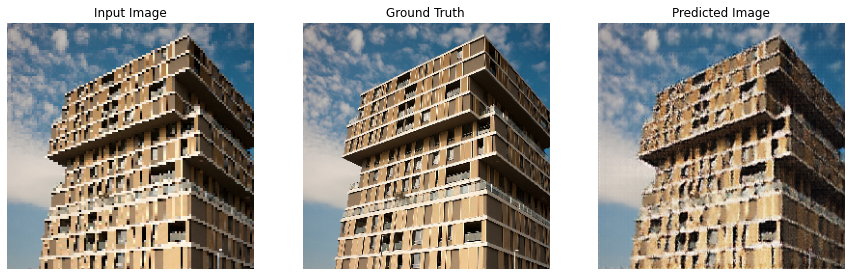

Epoch:  65
......................................................................
Time taken for epoch 66 is 12.284347772598267 sec



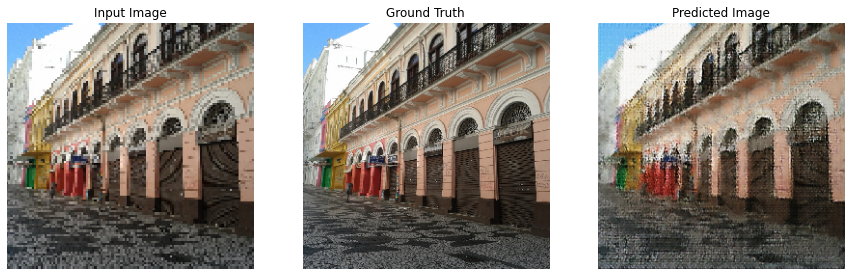

Epoch:  66
......................................................................
Time taken for epoch 67 is 12.722375392913818 sec



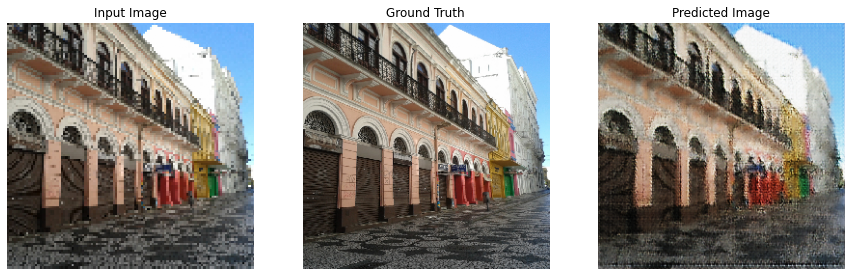

Epoch:  67
......................................................................
Time taken for epoch 68 is 13.146377563476562 sec



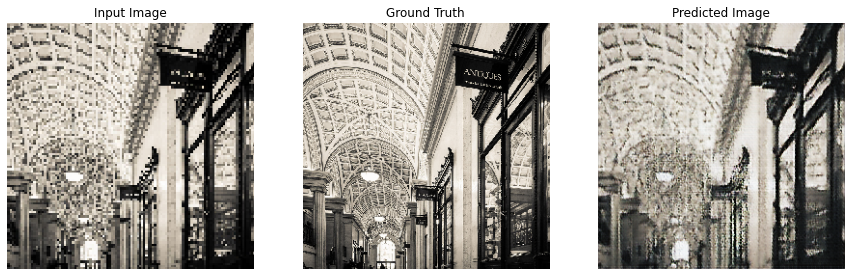

Epoch:  68
......................................................................
Time taken for epoch 69 is 13.368963956832886 sec



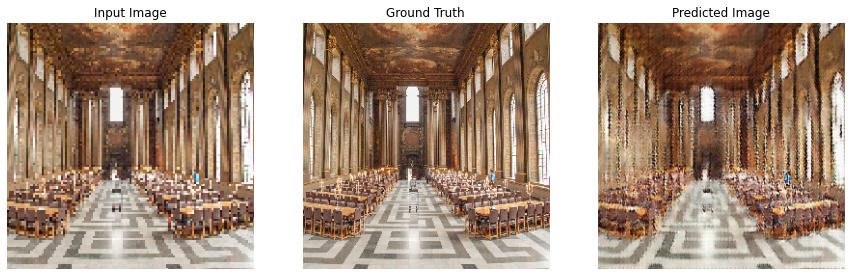

Epoch:  69
......................................................................
Time taken for epoch 70 is 15.75299596786499 sec



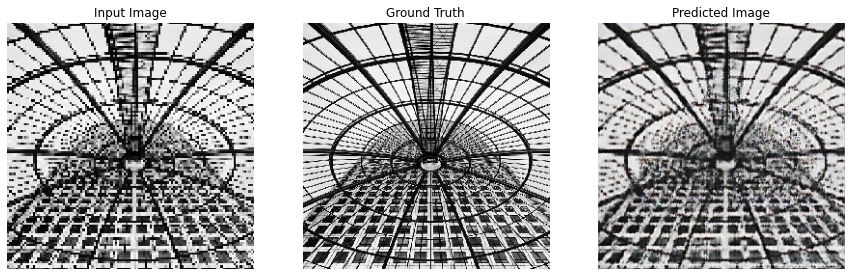

Epoch:  70
......................................................................
Time taken for epoch 71 is 12.250945568084717 sec



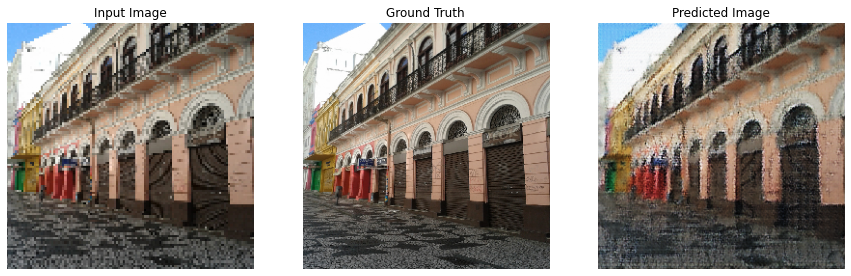

Epoch:  71
......................................................................
Time taken for epoch 72 is 13.457601547241211 sec



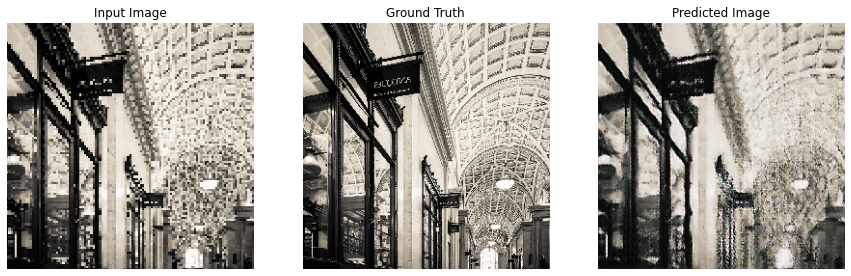

Epoch:  72
......................................................................
Time taken for epoch 73 is 13.707390546798706 sec



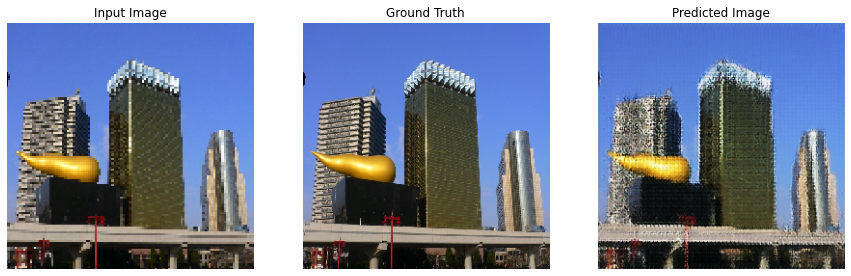

Epoch:  73
....................................................

KeyboardInterrupt: ignored

In [ ]:
fit(train_dataset, EPOCHS , val_dataset)
#fit(train_dataset, EPOCHS, val_dataset)